In [8]:
! pip install folium
! pip install geopy

In [615]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os
import geopandas as gpd
import folium
from shapely.geometry import Point

from sklearn.preprocessing import StandardScaler
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning) 

## 1.1 Load and preprocess features based on EDA parts
* We extracted temporal features such as month, day of the week, hour bins from pickup_datetime
* Trip_duration_min and distance_km were calculated 
* Catagorical features were encoded to numeric

In [458]:
df = pd.read_csv('nyc_taxi_trip_duration.csv')
df['id'] = df['id'].str.extract('(\d+)') # extract id from the trip id's number 
df['id'] = df['id'].astype('int64') # converting to integer
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'], format='%Y-%m-%d %H:%M:%S') # converting to datetime
df['dropoff_datetime'] = pd.to_datetime(df['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
df['trip_duration_min'] = (df['trip_duration']/60).astype(int)
df.drop(['trip_duration'], axis=1, inplace=True)
# we can drop dropoff_datetime as we have already got trip_duration
df.drop(['dropoff_datetime'], axis=1, inplace=True)

# Extract dayofyear, month, dayofweek, hourofday (all data is from 2016)--------------------------------------  
df['week_of_year'] = df['pickup_datetime'].apply(lambda x: x.strftime('%W')).astype(int)
df['month'] = df['pickup_datetime'].dt.month
df['day_of_week'] = df['pickup_datetime'].dt.dayofweek  # Monday=0, Sunday=6
#df['is_weekend'] = (df['day_of_week'].dt.dayofweek >= 5).astype(int)
df['hour_of_day'] = df['pickup_datetime'].dt.hour
# Create bin hour
bins = [-1, 4, 8, 12, 17, 21, 23]  
labels = ['0.00-4.59', '5.00-8.59', '9.00-12.58', '13.00-17.59', '18.00-21.59', '22.00-23.59']
df['hour_bin'] = pd.cut(df['hour_of_day'], bins=bins, labels=labels, include_lowest=True, right=True)
df.drop(['pickup_datetime','hour_of_day'], axis=1, inplace=True)


# Extract distance from location--------------------------------------   
# Convert to geodataframe set crs to WGS 84
df = gpd.GeoDataFrame(df)
df['geometry_pickup'] = gpd.points_from_xy(df.pickup_longitude, df.pickup_latitude)
df['geometry_dropoff'] = gpd.points_from_xy(df.dropoff_longitude, df.dropoff_latitude)
gdf_pickup = gpd.GeoDataFrame(geometry=df['geometry_pickup'], crs="EPSG:4326") 
gdf_dropoff = gpd.GeoDataFrame(geometry=df['geometry_dropoff'], crs="EPSG:4326")
# Project to World Mercator for metric distance calculations
gdf_pickup_metric = gdf_pickup.to_crs("EPSG:3395")
gdf_dropoff_metric = gdf_dropoff.to_crs("EPSG:3395")

# Calculate distances in meters
df['distance_km'] = (gdf_pickup_metric.distance(gdf_dropoff_metric.geometry))/1000
    
# Convert to numeric --------------------------------------  
#Convert to numeric for binary feature
df.replace({'store_and_fwd_flag': {'Y': 1, 'N':0}}, inplace = True)
df = pd.get_dummies(data=df, columns=['vendor_id', 'hour_bin', 'day_of_week','month'], drop_first=True)

print(df.info())
display(df)
print(df.columns)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 729322 entries, 0 to 729321
Data columns (total 29 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   id                    729322 non-null  int64   
 1   passenger_count       729322 non-null  int64   
 2   pickup_longitude      729322 non-null  float64 
 3   pickup_latitude       729322 non-null  float64 
 4   dropoff_longitude     729322 non-null  float64 
 5   dropoff_latitude      729322 non-null  float64 
 6   store_and_fwd_flag    729322 non-null  int64   
 7   trip_duration_min     729322 non-null  int32   
 8   week_of_year          729322 non-null  int32   
 9   geometry_pickup       729322 non-null  geometry
 10  geometry_dropoff      729322 non-null  geometry
 11  distance_km           729322 non-null  float64 
 12  vendor_id_2           729322 non-null  uint8   
 13  hour_bin_5.00-8.59    729322 non-null  uint8   
 14  hour_bin_9.00-12.58   729322

,id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration_min,week_of_year,geometry_pickup,...,day_of_week_2,day_of_week_3,day_of_week_4,day_of_week_5,day_of_week_6,month_2,month_3,month_4,month_5,month_6
0,1080784,1,-73.953918,40.778873,-73.963875,40.771164,0,6,9,POINT (-73.95392 40.77887),...,0,0,0,0,0,1,0,0,0,0
1,889885,2,-73.988312,40.731743,-73.994751,40.694931,0,18,10,POINT (-73.98831 40.73174),...,0,0,1,0,0,0,1,0,0,0
2,857912,2,-73.997314,40.721458,-73.948029,40.774918,0,27,7,POINT (-73.99731 40.72146),...,0,0,0,0,1,1,0,0,0,0
3,3744273,6,-73.961670,40.759720,-73.956779,40.780628,0,19,1,POINT (-73.96167 40.75972),...,0,0,0,0,0,0,0,0,0,0
4,232939,1,-74.017120,40.708469,-73.988182,40.740631,0,14,7,POINT (-74.01712 40.70847),...,1,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
729317,3905982,2,-73.965919,40.789780,-73.952637,40.789181,0,4,20,POINT (-73.96592 40.78978),...,0,0,0,1,0,0,0,0,1,0
729318,102861,1,-73.996666,40.737434,-74.001320,40.731911,0,5,8,POINT (-73.99667 40.73743),...,0,0,0,0,0,1,0,0,0,0
729319,439699,1,-73.997849,40.761696,-74.001488,40.741207,0,11,15,POINT (-73.99785 40.76170),...,0,0,1,0,0,0,0,1,0,0
729320,2078912,1,-74.006706,40.708244,-74.013550,40.713814,0,7,24,POINT (-74.00671 40.70824),...,0,0,0,0,1,0,0,0,0,1


Index(['id', 'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration_min', 'week_of_year', 'geometry_pickup',
       'geometry_dropoff', 'distance_km', 'vendor_id_2', 'hour_bin_5.00-8.59',
       'hour_bin_9.00-12.58', 'hour_bin_13.00-17.59', 'hour_bin_18.00-21.59',
       'hour_bin_22.00-23.59', 'day_of_week_1', 'day_of_week_2',
       'day_of_week_3', 'day_of_week_4', 'day_of_week_5', 'day_of_week_6',
       'month_2', 'month_3', 'month_4', 'month_5', 'month_6'],
      dtype='object')


In [73]:
# numerical univariate fuction
def UVA_numeric(data, var_group):
  '''
  Univariate_Analysis_numeric
  takes a group of variables (INTEGER and FLOAT) and plot/print all the descriptives and properties along with KDE.
  '''
  size = len(var_group)
  plt.figure(figsize = (7*size,3), dpi = 100)

  #looping for each variable
  for j,i in enumerate(var_group):
    # calculating descriptives of variable
    mini = data[i].min()
    maxi = data[i].max()
    ran = data[i].max()-data[i].min()
    mean = data[i].mean()
    median = data[i].median()
    st_dev = data[i].std()
    skew = data[i].skew()
    kurt = data[i].kurtosis()
    # calculating points of standard deviation
    points = mean-st_dev, mean+st_dev
    #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.kdeplot(data[i], fill=True)
    sns.lineplot(x=points, y=[0,0], color = 'black', label = "std_dev")
    sns.scatterplot(x=[mini,maxi], y=[0,0], color = 'orange', label = "min/max")
    sns.scatterplot(x=[mean], y=[0], color = 'red', label = "mean")
    sns.scatterplot(x=[median], y=[0], color = 'blue', label = "median")
    plt.xlabel('{}'.format(i), fontsize = 20)
    plt.ylabel('density')
    plt.title('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurt,2),
                                                                                                   round(skew,2),
                                                                                                   (round(mini,2),round(maxi,2),round(ran,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)))

def UVA_outlier(data, var_group):
  '''
  Univariate_Analysis_outlier:
  takes a group of variables (INTEGER and FLOAT) and plot/print boplot and descriptives\n
  '''

  size = len(var_group)
  plt.figure(figsize = (7*size,3), dpi = 100)
  
  #looping for each variable
  for j,i in enumerate(var_group):
    
    # calculating descriptives of variable
    quant25 = data[i].quantile(0.25)
    quant75 = data[i].quantile(0.75)
    IQR = quant75 - quant25
    med = data[i].median()
    whis_low = quant25-(1.5*IQR)
    whis_high = quant75+(1.5*IQR)

    # Calculating Number of Outliers
    outlier_high = len(data[i][data[i]>whis_high])
    outlier_low = len(data[i][data[i]<whis_low])

    #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.boxplot(data=data[i], orient="v")
    plt.ylabel('{}'.format(i))
    plt.title('With Outliers\nIQR = {}; Median = {} \n 1st,3rd  quartile = {};\n Outlier (low/high) = {} \n'.format(
                                                                                                   round(IQR,2),
                                                                                                   round(med,2),
                                                                                                   (round(quant25,2),round(quant75,2)),
                                                                                                   (outlier_low,outlier_high)
                                                                                                   ))
   

## 1.2 Feature transformation
* Filter extreme outlier (based on insight from EDA)before transforming the data can make the transformation more effective.
* Apply log transformation to reduce skewness in variables we found from EDA.
* Apply feature scaling before feeding regression model

Before filter:------------------


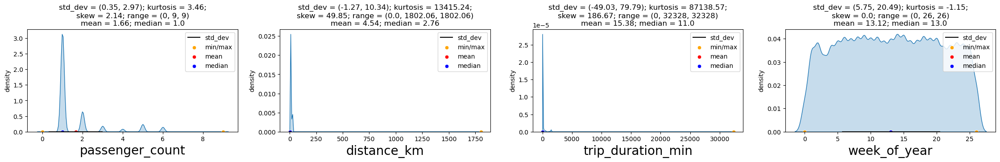

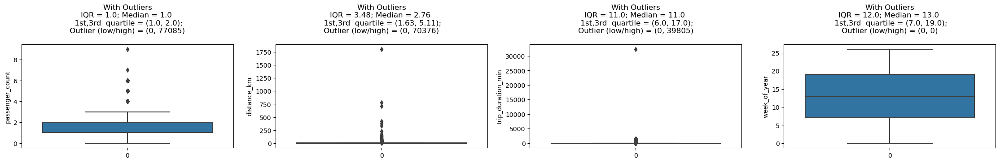


Apply filter:------------------


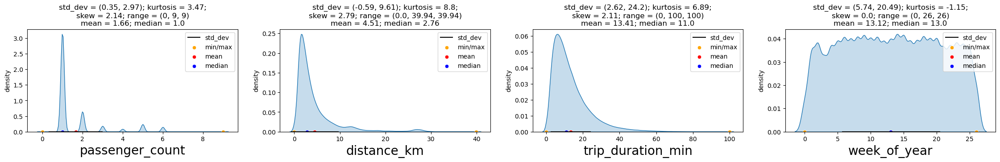

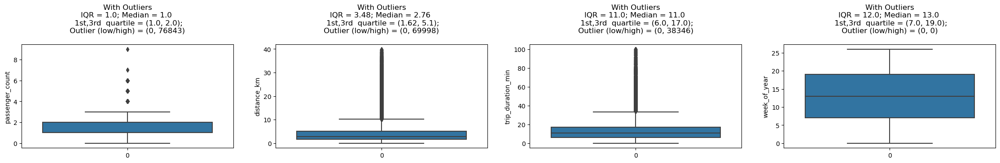

In [613]:
# Remove extreme outlier 
num_cols = ['passenger_count', 'distance_km','trip_duration_min', 'week_of_year'] 
print('Before filter:------------------')
UVA_numeric(df, num_cols)
UVA_outlier(df, num_cols)
plt.show()

filtered_df = df[(df['distance_km'] <= 40) & (df['trip_duration_min'] <= 100)]
# After filter
print('\nApply filter:------------------')
UVA_numeric(filtered_df, num_cols)
UVA_outlier(filtered_df, num_cols)

# Store geo columns and drop before feed the regression model
df_geo = filtered_df.copy()
filtered_df = filtered_df.drop(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
        'geometry_pickup','geometry_dropoff','id'], axis=1)


Apply log transform:------------------


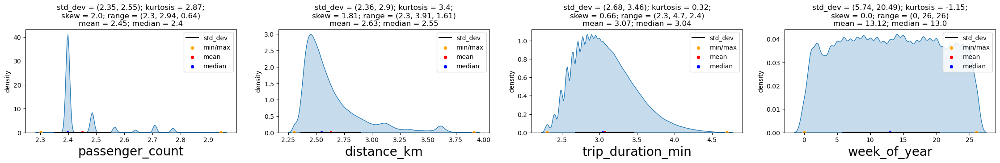


Apply StandardScaler:------------------


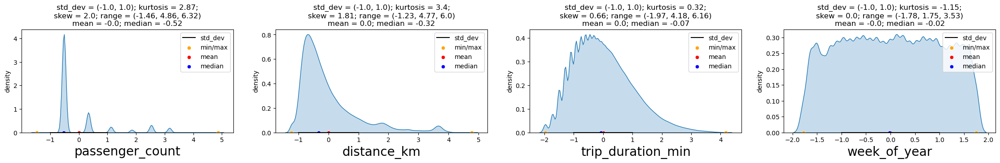

In [624]:
num_cols = ['passenger_count', 'distance_km', 'trip_duration_min', 'week_of_year']
log_cols = num_cols[:-1]  # Exclude 'week_of_year' for log transform

# Apply log transform only to the first three columns
log_df = filtered_df.copy()
for col in log_cols:
    log_df[col] = np.log(log_df[col] + 10)
    
print('\nApply log transform:------------------')
UVA_numeric(log_df, num_cols)
plt.show()

# Create a dataframe that combines the transformed columns with the original 'week_of_year'
combined_df = log_df[log_cols]
combined_df = pd.concat([combined_df, filtered_df[['week_of_year']]], axis=1)

# Scale the combined dataframe
std = StandardScaler()
scaled_data = std.fit_transform(combined_df)
scaled_df = pd.DataFrame(scaled_data, columns=num_cols, index=log_df.index)
print('\nApply StandardScaler:------------------')
UVA_numeric(scaled_df, num_cols)

## 2.0 Linear model and Inspect assumption Assumption of Linear Regression.
* Check Coeeficient of linear model
* Use Variance_inflation_Factor to check Multicollinearity that the variables should not be too highly correlated.
* Use residual error plot:
    * Check Linearity between the independent variables and the dependent variable.
    * Check Independence of Errors along with Durbin-Watson test
    * Check Homoscedasticity to ensure the variance of the residuals remain constant across all levels of the independent variables.
    * Check normality of Errors and verify that residuals are approximately normally distributed using Q-Q plots, histograms, and Shapiro-Wilk test.


### 2.1 Coefficient plot

Training Mean Absolute Error 0.4207550032852651
Test Mean Absolute Error     0.4221985362014732


Text(0.5, 1.0, 'Coefficient plot')

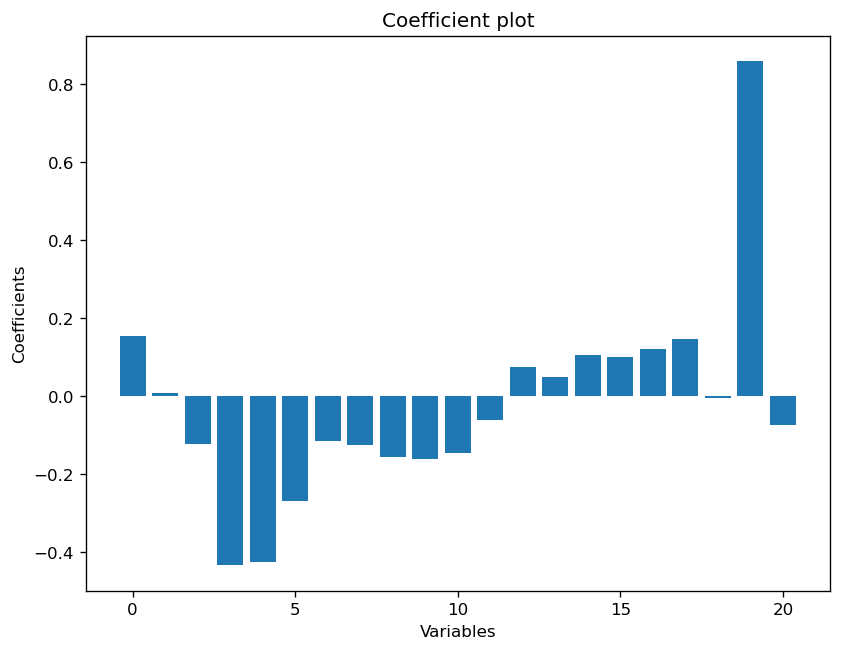

In [626]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression as LR
from sklearn.metrics import mean_absolute_error as mae

df_scaled = filtered_df.copy()
df_scaled = df_scaled.drop(columns = num_cols,axis = 1)
df_scaled = df_scaled.merge(scaled,left_index=True,right_index=True,how = "left")

Y = df_scaled.distance_km
X = df_scaled.drop(['distance_km'],axis = 1)

train_x,test_x,train_y,test_y = train_test_split(X,Y,test_size=1/3, random_state=42)

# Creating instance of Linear Regresssion-------------------------------------------
lr = LR()
# Fitting the model
lr.fit(train_x, train_y)

# Predicting over the Train Set and calculating error
train_predict = lr.predict(train_x)
k = mae(train_predict, train_y)
print('Training Mean Absolute Error', k )

# Predicting over the Test Set and calculating error
test_predict = lr.predict(test_x)
k = mae(test_predict, test_y)
print('Test Mean Absolute Error    ', k )


# Coefficient plot-----------------------------------------------------
plt.figure(figsize=(8, 6), dpi=120, facecolor='w', edgecolor='b')
x = range(len(train_x.columns))
y = lr.coef_
plt.bar( x, y )
plt.xlabel( "Variables")
plt.ylabel('Coefficients')
plt.title('Coefficient plot')
     # seem like the model sorely depends on some variables

### 2.2 Variance_inflation_Factor

In [627]:
# Check Variance_inflation_Factor ------------------------------------------------------------
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Calculating VIF for every column (only works for the not Catagorical)
VIF = pd.Series([variance_inflation_factor(X.values, i) for i in range(X.shape[1])], index =X.columns)
print(VIF)

# Multicollinearity: 
    # REMOVE some predictors with inf values ( a clear indication of perfect multicollinearity among predictors)
    # high VIF values includes  month_4, month_5, month_6, week_of_year indicates multicollinearity issues

store_and_fwd_flag      1.012455
vendor_id_2             2.324923
hour_bin_5.00-8.59      2.064709
hour_bin_9.00-12.58     2.634504
hour_bin_13.00-17.59    3.134733
hour_bin_18.00-21.59    3.099020
hour_bin_22.00-23.59    1.905398
day_of_week_1           2.024462
day_of_week_2           2.080231
day_of_week_3           2.125336
day_of_week_4           2.203877
day_of_week_5           2.212214
day_of_week_6           2.107308
month_2                 1.971846
month_3                 3.346653
month_4                 5.125611
month_5                 7.031713
month_6                 8.826818
passenger_count         1.089501
trip_duration_min       1.020623
week_of_year            7.001575
dtype: float64

### 2.3 Residual Plot

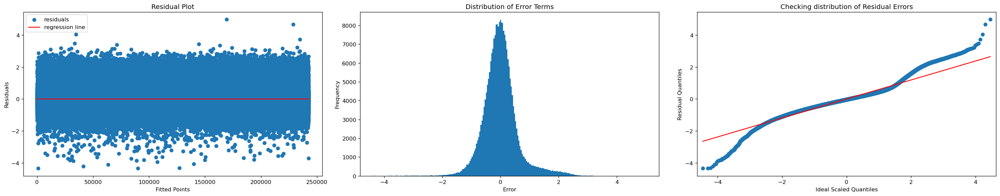

Shapiro-Wilk Test: ShapiroResult(statistic=0.9147765636444092, pvalue=0.0)
Durbin-Watson: [1.99766928 1.99721859 1.99866502]


In [636]:
import scipy.stats as stats
from statsmodels.stats.stattools import durbin_watson

# Arranging and calculating the Residuals
residuals = pd.DataFrame({
    'fitted values' : test_y,
    'predicted values' : test_predict,
})
residuals['residuals'] = residuals['fitted values'] - residuals['predicted values']


def plot_residual_analysis(residuals):
    # Create a figure with 3 subplots arranged in 3 rows and 1 column
    fig = plt.figure(figsize=(25, 5), dpi=120, facecolor='w', edgecolor='b')
    
    # Residual Plot
    ax1 = plt.subplot(1,3, 1)
    f = range(0, len(residuals))
    k = [0 for i in range(0, len(residuals))]
    ax1.scatter(f, residuals.residuals, label='residuals')
    ax1.plot(f, k, color='red', label='regression line')
    ax1.set_xlabel('Fitted Points')
    ax1.set_ylabel('Residuals')
    ax1.set_title('Residual Plot')
    ax1.legend()
    
    # Histogram for distribution of error
    ax2 = plt.subplot(1,3, 2)
    ax2.hist(residuals.residuals, bins=250)
    ax2.set_xlabel('Error')
    ax2.set_ylabel('Frequency')
    ax2.set_title('Distribution of Error Terms')
    
    # QQ plot
    ax3 = plt.subplot(1,3, 3)
    qqplot(residuals.residuals, line='s', ax=ax3)
    ax3.set_ylabel('Residual Quantiles')
    ax3.set_xlabel('Ideal Scaled Quantiles')
    ax3.set_title('Checking distribution of Residual Errors')
    
    # Adjust the layout so plots do not overlap
    plt.tight_layout()
    plt.show()
    
    #  check for the normality of data
    shapiro_test = stats.shapiro(residuals)
    print(f"Shapiro-Wilk Test: {shapiro_test}")
    
    # detect the presence of autocorrelation (a relationship between values separated from each other
    durbinWatson = durbin_watson(residuals)
    print(f"Durbin-Watson: {durbinWatson}")

plot_residual_analysis(residuals)

* Residual plot: 
    * while the residuals seem to hover around zero for most of the data points, there's a pattern near the beginning of the plot where the residuals are consistently positive. 
    * This indicates potential non-linearity in the model
    * Some outliers are visible too, which might affect the model's robustness.

* Normality:
    * Histogram indicates fairly normal distribution shape but with a pronounced skewness to the left/ negative, meaning there are more significant negative residuals than positive ones.
    * Q-Q plot shows that most of the residuals lie along the red line, but the tail on the left deviates from the line, confirming the negative skewness observed in the histogram.
    * Shapiro-Wilk test also indicates non-normality 

* Autocorrelation:
    * a Durbin-Watson statistics are very close to 2, suggesting that there is no significant autocorrelation in the residuals.







## 3.0 Model selection and evaluation
* Baseline Model: 
    * Build a model using only the significant columns identified during the EDA. This serves as a reference point for comparing other models.
* All Feature Model: 
    * Construct a model using all available features. This helps in determining if incorporating all features improves performance compared to the baseline.
* Feature Selection Model: 
    * Implement backward selection to identify a subset of features that provides the best model performance.
* Evaluation Metrics: 
    * For regression model, MAE and MSE will be used to evaluate the average prediction error, whereas R2 and Adjusted R² will used to explain how well models fits the data

In [657]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_absolute_error as mae, mean_squared_error as mse, r2_score
from sklearn.model_selection import KFold, cross_val_score
from sklearn.preprocessing import StandardScaler
import numpy as np

def adjusted_r2(r2, n, p):
    """
    Compute adjusted R².
    """
    return 1 - (1 - r2) * (n - 1) / (n - p - 1)


def ridge_kfold_validation(X, Y , n_splits=5):
    """
    Perform Ridge regression with k-fold cross-validation to find the best alpha.
    """    
    # Normalize the features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    # Set up k-fold cross-validation
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    
    best_alpha = None
    best_score = float('inf')  # Initialize with a high value
    
    train_mae_values = []
    val_mae_values = []
    
    alphas=[0,0.001, 0.01, 0.1, 1.0, 10, 100, 500]
    
    for alpha in alphas:
        ridge = Ridge(alpha=alpha)
  
        # Store train and validate MAE
        train_mae_scores = []
        val_mae_scores = []
        
        for train_idx, val_idx in kf.split(X_scaled):
            ridge.fit(X_scaled[train_idx], Y.iloc[train_idx])
            
            # Training MAE
            train_pred = ridge.predict(X_scaled[train_idx])
            train_mae_scores.append(mae(Y.iloc[train_idx], train_pred))
            
            # Validation MAE
            val_pred = ridge.predict(X_scaled[val_idx])
            val_mae_scores.append(mae(Y.iloc[val_idx], val_pred))
            
        train_mae_values.append(np.mean(train_mae_scores))
        val_mae_values.append(np.mean(val_mae_scores))
        
        # Display the metrics
        print(f"Metrics for alpha={alpha}\n   Train MAE: {np.mean(train_mae_scores)} | Val MAE: {np.mean(val_mae_scores)}")
        
        if np.mean(val_mae_scores) < best_score:
            best_score = np.mean(val_mae_scores)
            best_alpha = alpha

    return best_alpha, best_score, train_mae_values, val_mae_values

def train_and_evaluate(model, train_x, train_y, test_x, test_y, best_alpha):
    """
    Train the provided model using the training data and evaluate its performance on the test data.
    """
    scaler = StandardScaler()
    train_x_scaled = scaler.fit_transform(train_x)
    test_x_scaled = scaler.transform(test_x)
    
    # Train the model using the entire training data and the best alpha
    model.alpha = best_alpha
    model.fit(train_x_scaled, train_y)

    # Predict on the test set
    test_predictions = model.predict(test_x_scaled)

    # Compute evaluation metrics
    metrics = {
        'Mean Absolute Error': mae(test_y, test_predictions),
        'Mean Squared Error ': mse(test_y, test_predictions),
        'R2                 ': r2_score(test_y, test_predictions),
        'Adjusted R2        ': adjusted_r2(r2_score(test_y, test_predictions), test_x.shape[0], test_x.shape[1])
    }

    return metrics, model


def plot_coefficients(model, feature_names):
    """
    Plot the coefficients of a trained linear model.
    """
    Coefficients = pd.DataFrame({
        'Variable'    : feature_names,
        'coefficient' : model.coef_
    })
    plt.figure(figsize=(8, 4), dpi=120, facecolor='w', edgecolor='b')
    plt.bar(Coefficients['Variable'], Coefficients['coefficient'])
    plt.xlabel('Variables')
    plt.ylabel('Coefficients')
    plt.xticks(Coefficients['Variable'], rotation='vertical')
    plt.title('Coefficient plot')
    plt.show()

### 3.1 Baseline Model

Metrics for alpha=0
   Train MAE: 0.422570410423477 | Val MAE: 0.4225845375098568
Metrics for alpha=0.001
   Train MAE: 0.4225704100495028 | Val MAE: 0.4225845371358667
Metrics for alpha=0.01
   Train MAE: 0.42257040668373547 | Val MAE: 0.42258453376995553
Metrics for alpha=0.1
   Train MAE: 0.4225703730261393 | Val MAE: 0.4225845001108609
Metrics for alpha=1.0
   Train MAE: 0.4225700364567852 | Val MAE: 0.4225841635533783
Metrics for alpha=10
   Train MAE: 0.42256667134485176 | Val MAE: 0.42258079953140604
Metrics for alpha=100
   Train MAE: 0.42253308948887536 | Val MAE: 0.42254722912680565
Metrics for alpha=500
   Train MAE: 0.42238534107756587 | Val MAE: 0.42239946538614
**********
Best Alpha: 500
Average MAE with best alpha:    0.42239946538614
**********

Metrics on Test Data:
Mean Absolute Error: 0.42204724302834473
Mean Squared Error : 0.35369734705448713
R2                 : 0.6421701016208705
Adjusted R2        : 0.6421391262963945


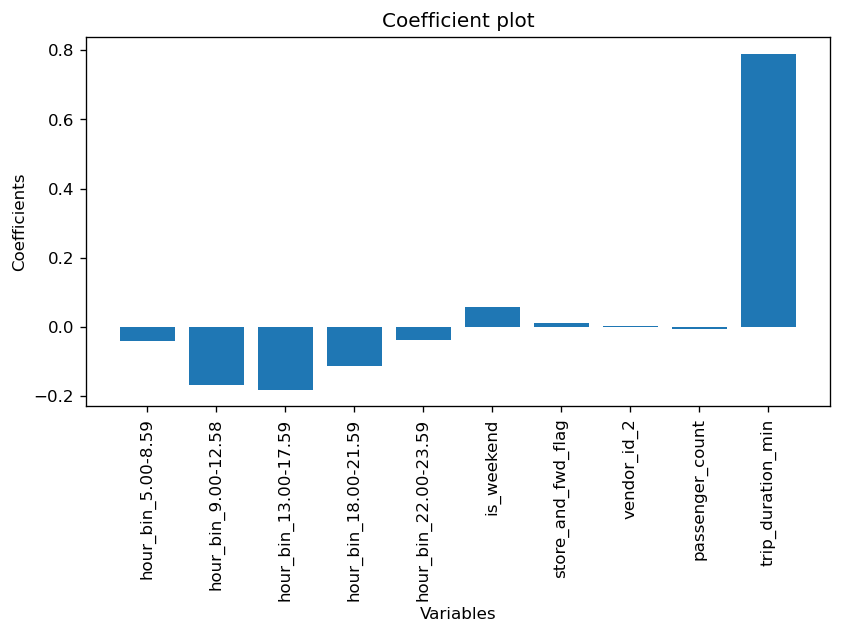

In [658]:
X_baseline = X.copy()
X_baseline['is_weekend'] = 0  # first initialize the column with zeros
X_baseline.loc[((X['day_of_week_6'] == 1) | (X['day_of_week_5'] == 1)), 'is_weekend'] = 1
col_base = ['hour_bin_5.00-8.59','hour_bin_9.00-12.58', 'hour_bin_13.00-17.59', 'hour_bin_18.00-21.59','hour_bin_22.00-23.59',
            'is_weekend','store_and_fwd_flag', 'vendor_id_2',
            'passenger_count', 'trip_duration_min']
X_baseline = X_baseline[col_base]


train_x,test_x,train_y,test_y = train_test_split(X_baseline,Y,test_size=1/3, random_state=42)
# find he best alpha from k-fold validation
best_alpha, best_score, train_mae_values, val_mae_values = ridge_kfold_validation(train_x, train_y, n_splits=5)
print('*'*10)
print('Best Alpha:', best_alpha)
print('Average MAE with best alpha:   ', best_score)
print('*'*10)


# train the Ridge regression model using the entire training data and the best alpha and predict
ridge = Ridge()
results_baseline, model_baseline = train_and_evaluate(ridge, train_x, train_y, test_x, test_y, best_alpha)
print('\nMetrics on Test Data:')
for key, value in results_all.items():
    print(f'{key}: {value}')

plot_coefficients(model_baseline, X_baseline.columns)

### 3.2 All-feature Model

Metrics for alpha=0
   Train MAE: 0.4207527393346401 | Val MAE: 0.4207831065674307
Metrics for alpha=0.001
   Train MAE: 0.42075273893132553 | Val MAE: 0.42078310616355513
Metrics for alpha=0.01
   Train MAE: 0.42075273530149626 | Val MAE: 0.4207831025286768
Metrics for alpha=0.1
   Train MAE: 0.4207526990032959 | Val MAE: 0.42078306617998756
Metrics for alpha=1.0
   Train MAE: 0.4207523360427022 | Val MAE: 0.4207827027207448
Metrics for alpha=10
   Train MAE: 0.4207487085765571 | Val MAE: 0.42077907072679055
Metrics for alpha=100
   Train MAE: 0.4207126580308668 | Val MAE: 0.4207429658479186
Metrics for alpha=500
   Train MAE: 0.4205566801598959 | Val MAE: 0.42058686087651154
**********
Best Alpha: 500
Average MAE with best alpha:    0.42058686087651154
**********

Metrics on Test Data:
Mean Absolute Error: 0.42204724302834473
Mean Squared Error : 0.35369734705448713
R2                 : 0.6421701016208705
Adjusted R2        : 0.6421391262963945


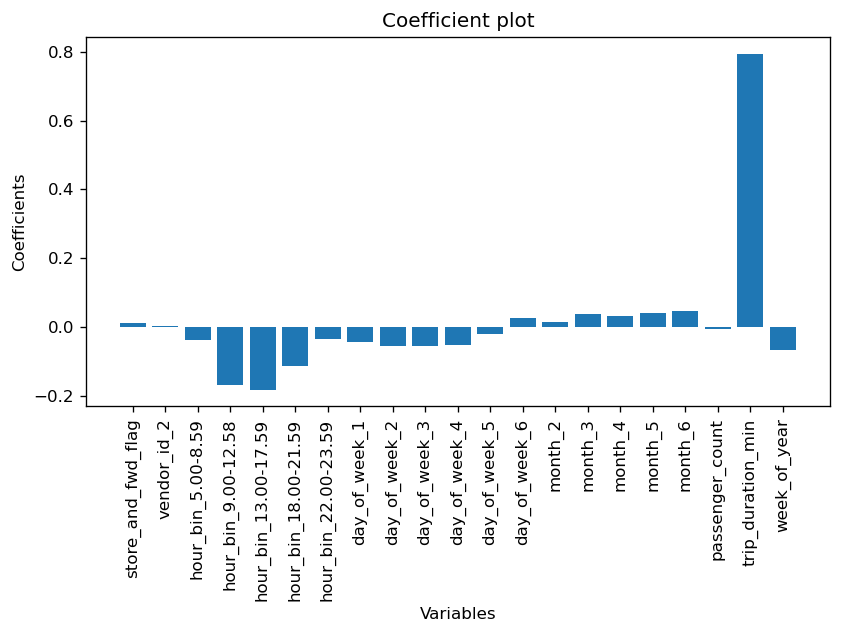

In [659]:
train_x,test_x,train_y,test_y = train_test_split(X,Y,test_size=1/3, random_state=42)
# find he best alpha from k-fold validation
best_alpha, best_score, train_mae_values, val_mae_values = ridge_kfold_validation(train_x, train_y, n_splits=5)
print('*'*10)
print('Best Alpha:', best_alpha)
print('Average MAE with best alpha:   ', best_score)
print('*'*10)


# train the Ridge regression model using the entire training data and the best alpha and predict
ridge = Ridge()
results_all, model_all = train_and_evaluate(ridge, train_x, train_y, test_x, test_y, best_alpha)
print('\nMetrics on Test Data:')
for key, value in results_all.items():
    print(f'{key}: {value}')
    
plot_coefficients(model_all, X.columns)

### 3.3 Backward selection Model

            Feature_name  Rank
19     trip_duration_min     1
3    hour_bin_9.00-12.58     2
4   hour_bin_13.00-17.59     3
12         day_of_week_6     4
5   hour_bin_18.00-21.59     5
0     store_and_fwd_flag     6
2     hour_bin_5.00-8.59     7
6   hour_bin_22.00-23.59     8
9          day_of_week_3     9
8          day_of_week_2    10
10         day_of_week_4    11
7          day_of_week_1    12
11         day_of_week_5    13
14               month_3    14
20          week_of_year    15
17               month_6    16
16               month_5    17
15               month_4    18
13               month_2    19
1            vendor_id_2    20
18       passenger_count    21
Metrics for alpha=0
   Train MAE: 0.421880717539384 | Val MAE: 0.4218937338028838
Metrics for alpha=0.001
   Train MAE: 0.42188071717140313 | Val MAE: 0.4218937334350309
Metrics for alpha=0.01
   Train MAE: 0.42188071385957643 | Val MAE: 0.4218937301243543
Metrics for alpha=0.1
   Train MAE: 0.4218806807413248 | Val 

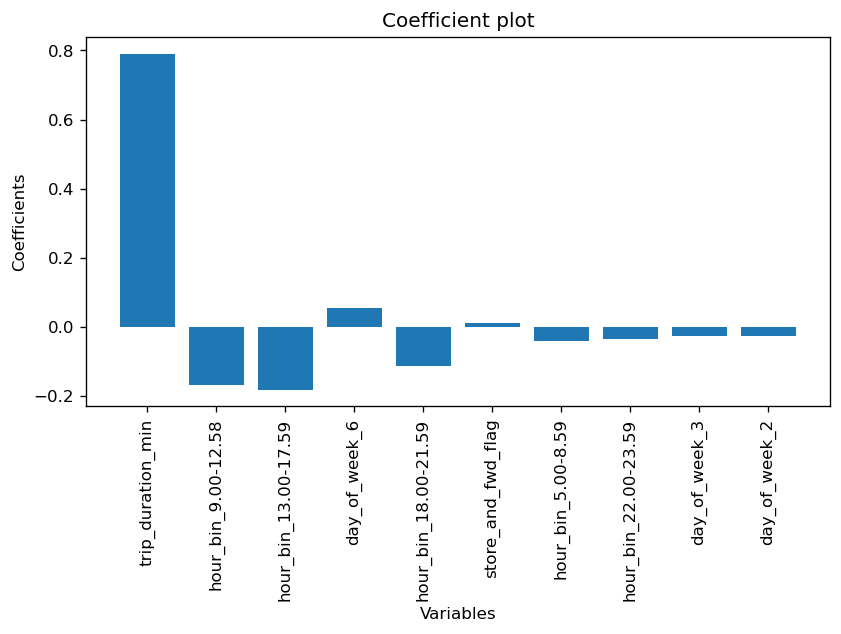

In [660]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression as LR
 
model = LR()
rfe = RFE(estimator=model, n_features_to_select=1, step=1)  # Here, 10 means you want to select top 10 features. Adjust this number based on your needs.
fit = rfe.fit(X, Y)
ranking_df = pd.DataFrame()
ranking_df['Feature_name'] = X.columns
ranking_df['Rank'] = rfe.ranking_
ranked = ranking_df.sort_values(by=['Rank'])
print(ranked)
# sort top 10 feature
cols = ranked['Feature_name'][:10].values

train_x,test_x,train_y,test_y = train_test_split(X[cols],Y,test_size=1/3, random_state=42)
# find he best alpha from k-fold validation
best_alpha, best_score, train_mae_values, val_mae_values = ridge_kfold_validation(train_x, train_y, n_splits=5)
print('*'*10)
print('Best Alpha:', best_alpha)
print('Average MAE with best alpha:   ', best_score)
print('*'*10)


# train the Ridge regression model using the entire training data and the best alpha and predict
ridge = Ridge()
results_top10, model_top10= train_and_evaluate(ridge, train_x, train_y, test_x, test_y, best_alpha)
print('\nMetrics on Test Data:')
for key, value in results_top10.items():
    print(f'{key}: {value}')
plot_coefficients(model_top10, X[cols].columns)  

## 3.4 Model Comparision

<AxesSubplot:>

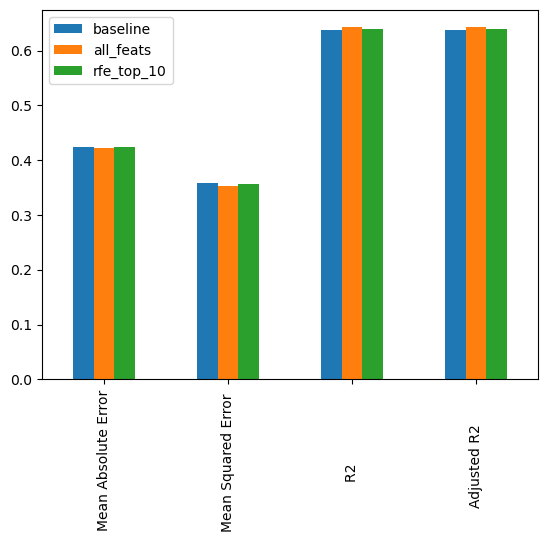

In [451]:
model_compare = pd.DataFrame({'baseline':results_baseline ,'all_feats': results_all, 'rfe_top_10': results_top10})
model_compare.plot(y=[ 'baseline', 'all_feats', 'rfe_top_10'], kind="bar")

* There is no significant difference between three models. The metrics indicates well generalize from validation to testing with similar MAE values.
* An R2 value of 0.64 indicates a decent fit, though there's still room for improvement.
* Suggestion includes exploring other feature engineering such as clustering group of pickup-drop off location

## 4.0 Location-based Clustering Model
* Use K-means to extract locational data from latitute and longtitute features 
* The approach includes
    * Scale pickup and dropoff location-feature into the same range of latitude and longitude values across both datasets.
    * Combine the scaled pickup and dropoff data to cluster both pickup and drop-off together and assign them to the same cluster groups. 
    * Apply gridsearch to find the best number of cluster on the sample set before apply the full dataset.
    * Apply One-hot encoding to cluster columns before feeding the regression model.

### 4.1 Clustering a sample set using the hyperparamter from gridsearch

In [528]:
# Extract cluster from geo columns
geo_cols = ['pickup_longitude', 'pickup_latitude', 'dropoff_longitude','dropoff_latitude', 'geometry_pickup', 'geometry_dropoff']
df_geo = df_geo[geo_cols]

# use sample set to find hyperparamter for clustering
sample_fraction = 0.25
df_geo_sample = df_geo.sample(frac=sample_fraction, random_state=42)

In [550]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

def scale_and_cluster(data, n_clusters=29):
    # Combine pickup and drop-off coordinates
    combined_coordinates = np.vstack((data[['pickup_latitude', 'pickup_longitude']].values,
                                      data[['dropoff_latitude', 'dropoff_longitude']].values))
    
    # Fit the scaler on combined coordinates
    scaler = StandardScaler().fit(combined_coordinates)
    
    # Transform pickup and drop-off coordinates using the same scaler
    pickup_scaled = scaler.transform(data[['pickup_latitude', 'pickup_longitude']])
    dropoff_scaled = scaler.transform(data[['dropoff_latitude', 'dropoff_longitude']])
    
    # Combine the scaled data
    combined_scaled = np.vstack((pickup_scaled, dropoff_scaled))
    
    # Apply KMeans clustering
    kmeans = KMeans(n_clusters=n_clusters).fit(combined_scaled)
    
    # Split the cluster labels into two: one for pickup and one for drop-off
    pickup_labels = kmeans.labels_[:len(pickup_scaled)]
    dropoff_labels = kmeans.labels_[len(pickup_scaled):]
    
    # Add the labels to the dataframe
    data['pickup_cluster'] = pickup_labels
    data['dropoff_cluster'] = dropoff_labels

    return data   

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,geometry_pickup,geometry_dropoff,pickup_cluster,dropoff_cluster
313660,-74.000374,40.726501,-73.990135,40.732937,POINT (-74.00037 40.72650),POINT (-73.99014 40.73294),3,24
431538,-73.789909,40.643490,-73.786263,40.746529,POINT (-73.78991 40.64349),POINT (-73.78626 40.74653),1,26
463086,-74.005257,40.722328,-73.990616,40.724411,POINT (-74.00526 40.72233),POINT (-73.99062 40.72441),3,27
156580,-73.961327,40.765190,-73.982307,40.774311,POINT (-73.96133 40.76519),POINT (-73.98231 40.77431),4,16
104838,-73.979958,40.751518,-73.987984,40.741104,POINT (-73.97996 40.75152),POINT (-73.98798 40.74110),0,24
...,...,...,...,...,...,...,...,...
708814,-73.989075,40.747841,-73.983559,40.755810,POINT (-73.98907 40.74784),POINT (-73.98356 40.75581),14,0
663056,-73.982521,40.746639,-73.864883,40.770393,POINT (-73.98252 40.74664),POINT (-73.86488 40.77039),0,17
418164,-73.991676,40.749836,-73.980820,40.738140,POINT (-73.99168 40.74984),POINT (-73.98082 40.73814),14,24
51617,-73.956741,40.766399,-73.974335,40.756474,POINT (-73.95674 40.76640),POINT (-73.97433 40.75647),4,12


In [551]:
from sklearn.model_selection import GridSearchCV

'''
# Define a custom scorer using the negative of the KMeans inertia to find the best n_clusters using GridSearchCV
def scorer(estimator, X):
    return -estimator.inertia_
param_grid = {
    'n_clusters': list(range(5,30,2))
}

grid_search = GridSearchCV(KMeans(), param_grid, scoring=scorer, cv=3)  # cv is for cross-validation
grid_search.fit(combined_scaled_samples)
best_n_clusters = grid_search.best_params_['n_clusters']
print(f"Best number of clusters: {best_n_clusters}")
'''

'\n# Define a custom scorer using the negative of the KMeans inertia to find the best n_clusters using GridSearchCV\ndef scorer(estimator, X):\n    return -estimator.inertia_\nparam_grid = {\n    \'n_clusters\': list(range(5,30,2))\n}\n\ngrid_search = GridSearchCV(KMeans(), param_grid, scoring=scorer, cv=3)  # cv is for cross-validation\ngrid_search.fit(combined_scaled_samples)\nbest_n_clusters = grid_search.best_params_[\'n_clusters\']\nprint(f"Best number of clusters: {best_n_clusters}")\n'

In [572]:
def plot_map_cluster(geo_data, geometry_point, cluster, num_points=5000):
    """
    Plots a folium map.
    """
    # New York City bounding box (example coordinates)
    minx, miny, maxx, maxy = [-74.2591, 40.4774, -73.7004, 40.9176] 
    # Filtering data within the bounding box
    geo_data = geo_data.set_geometry(geometry_point)
    geo_data_filtered = geo_data.cx[minx:maxx, miny:maxy]
    
    point_x = geo_data_filtered.geometry.x
    point_y = geo_data_filtered.geometry.y
    
    # Creating a base map
    m = folium.Map(location=[point_y.mean(), point_x.mean()], 
                   tiles='CartoDB Positron',  # Set initial tiles
                   zoom_start=11)
    sample_data = geo_data_filtered.sample(num_points)

    # Generate a color palette for the number of unique clusters
    # Fixed color palette for up to 50 clusters
    fixed_colors = sns.color_palette("Spectral", 30).as_hex()

    # Fetch the cluster color from the fixed palette
    cluster_colors = {cluster_num: fixed_colors[cluster_num] for cluster_num in sample_data[cluster].unique()}

    # Adding points to the map
    for _, row in sample_data.iterrows():
        cluster_color = cluster_colors[row[cluster]]
        # Create the tooltip text
        tooltip_text = f"Cluster: {row[cluster]}"

        folium.CircleMarker(
            location=[row[geometry_point].y, row[geometry_point].x],
            radius=3,
            color=cluster_color,
            tooltip=tooltip_text,
            fill=True,
            fill_opacity=0.6
        ).add_to(m)
        
    return m

from IPython.display import HTML
def display_maps(map1, map2, height=200): #
    """
    Displays two maps side by side.
    """
    map1_html = folium.Map._repr_html_(map1)
    map2_html = folium.Map._repr_html_(map2)
    
    maps_html = f"""
        <div style="display:flex;">
            <div style="width:50%; height:100%;">{map1_html}</div>
            <div style="width:50%; height:100%;">{map2_html}</div>
        </div>
    """
    return HTML(maps_html)

In [666]:
df_geo_sample = scale_and_cluster(df_geo_sample)

map_pickup = plot_map_cluster(df_geo_sample, geometry_point='geometry_pickup', cluster='pickup_cluster')
map_dropoff = plot_map_cluster(df_geo_sample, geometry_point='geometry_dropoff', cluster='dropoff_cluster')
display_maps(map_pickup,map_dropoff)

### 4.2. Clustering full dataset

In [668]:
df_geo = scale_and_cluster(df_geo_sample)

map_pickup = plot_map_cluster(df_geo, geometry_point='geometry_pickup', cluster='pickup_cluster')
map_dropoff = plot_map_cluster(df_geo, geometry_point='geometry_dropoff', cluster='dropoff_cluster')
display_maps(map_pickup,map_dropoff)

### 4.3 Encode cluster columns and combine with baseline model

In [669]:
col = ['pickup_cluster','dropoff_cluster']
df_geo = df_geo[col]

from sklearn.preprocessing import OneHotEncoder

encoder = OneHotEncoder(sparse=False, drop='first')  # drop='first' to avoid multicollinearity
encoded_clusters = encoder.fit_transform(df_geo)

# Convert to DataFrame 
df_geo_encoded = pd.DataFrame(encoded_clusters, columns=encoder.get_feature_names_out(['pickup_cluster', 'dropoff_cluster']), index=df_geo.index)
X_baseline_geo = pd.concat([X_baseline, df_geo_encoded], axis=1)
df_geo_encoded

,pickup_cluster_1,pickup_cluster_2,pickup_cluster_3,pickup_cluster_4,pickup_cluster_5,pickup_cluster_6,pickup_cluster_7,pickup_cluster_8,pickup_cluster_9,pickup_cluster_10,...,dropoff_cluster_19,dropoff_cluster_20,dropoff_cluster_21,dropoff_cluster_22,dropoff_cluster_23,dropoff_cluster_24,dropoff_cluster_25,dropoff_cluster_26,dropoff_cluster_27,dropoff_cluster_28
313660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
431538,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
463086,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
156580,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
104838,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
708814,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
663056,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
418164,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51617,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Metrics for alpha=0
   Train MAE: 0.3133213557121976 | Val MAE: 5047879694.267185
Metrics for alpha=0.001
   Train MAE: 0.3128653502686124 | Val MAE: 0.31293685351557415
Metrics for alpha=0.01
   Train MAE: 0.3128653494807646 | Val MAE: 0.3129368527231279
Metrics for alpha=0.1
   Train MAE: 0.31286534160229407 | Val MAE: 0.31293684479867145
Metrics for alpha=1.0
   Train MAE: 0.31286526282703836 | Val MAE: 0.31293676557101424
Metrics for alpha=10
   Train MAE: 0.3128644756112126 | Val MAE: 0.3129359744685437
Metrics for alpha=100
   Train MAE: 0.31285667479965895 | Val MAE: 0.31292813458835866
Metrics for alpha=500
   Train MAE: 0.31282350664102454 | Val MAE: 0.31289476460340254
**********
Best Alpha: 500
Average MAE with best alpha:    0.31289476460340254
**********

Metrics on Test Data:
Mean Absolute Error: 0.31342118084003295
Mean Squared Error : 0.19834774288686546
R2                 : 0.7993347892711136
Adjusted R2        : 0.7992801862675634


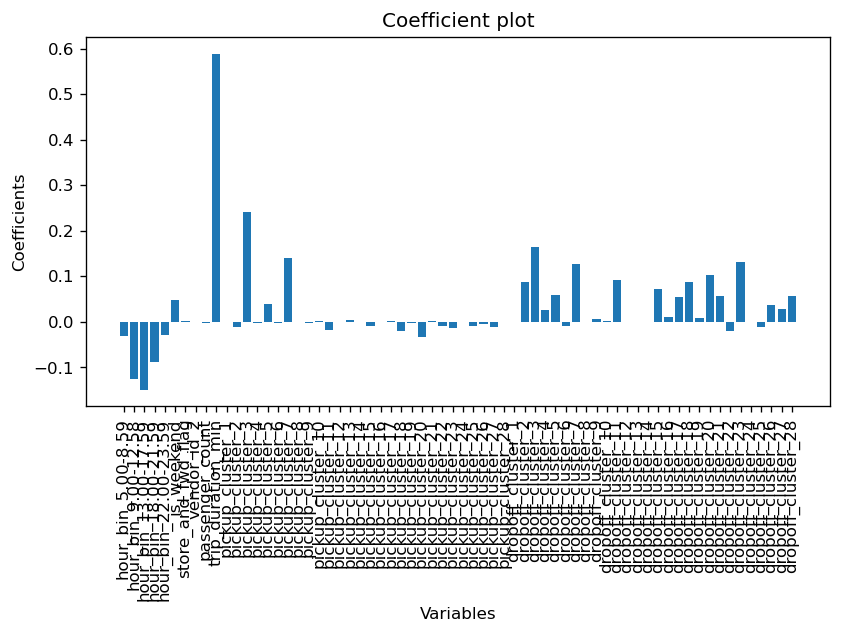

In [665]:
train_x,test_x,train_y,test_y = train_test_split(X_baseline_geo,Y,test_size=1/3, random_state=42)
# find he best alpha from k-fold validation
best_alpha, best_score, train_mae_values, val_mae_values = ridge_kfold_validation(train_x, train_y, n_splits=5)
print('*'*10)
print('Best Alpha:', best_alpha)
print('Average MAE with best alpha:   ', best_score)
print('*'*10)


# train the Ridge regression model using the entire training data and the best alpha and predict
ridge = Ridge()
results_baseline_geo, model_baseline_geo= train_and_evaluate(ridge, train_x, train_y, test_x, test_y, best_alpha)
print('\nMetrics on Test Data:')
for key, value in results_baseline_geo.items():
    print(f'{key}: {value}')

plot_coefficients(model_baseline_geo, X_baseline_geo.columns)  

### 4.4 Final Model comparision

<AxesSubplot:>

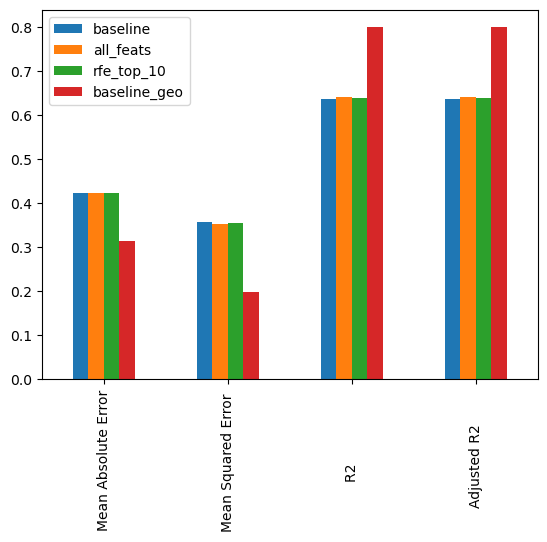

In [607]:
model_compare = pd.DataFrame({'baseline':results_baseline ,
                              'all_feats': results_all, 
                              'rfe_top_10': results_top10,
                              'baseline_geo':results_baseline_geo})
model_compare.plot(y=[ 'baseline', 'all_feats', 'rfe_top_10','baseline_geo'], kind="bar")

* Incorporating location cluster features into the baseline model has enhanced the regression model's performance. This is evidenced by the reduction in both MAE and MSE values and an increase in the R^2 value to 0.8. This indicates that the model's independent variables can now explain 80% of the variability in the dependent variable.
* The MAE values for both validation and test sets are quite close, suggesting that the model generalizes well from the training data to unseen data.
* As MSE (0.1983) is smaller than MAE (0.3134), it suggests that there aren't extremely large errors significantly skewing the MSE. 
* The regularization strength (Alpha 500) for Ridge regression resulting in the best performance on an average performance from cross-validation and reduces overfitting while still capturing the underlying patterns in the data
